<a href="https://colab.research.google.com/github/sgathai/dsc-data-serialization-lab/blob/master/starter_notebook_Zindi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Starter Notebook: AIMS Data Science Hackathon by Microsoft

Welcome! This starter notebook is designed to get you started on the AIMS Data Science Hackathon, where you will be attempting to predict a measure of wealth for different locations across Africa. We will take a look at the data, create a model and then use that to make our first submission. After that we will briefly look at some ways to improve. Let's get started.

# Loading the Data

We're using the pandas library to load the data into dataframes - a tabular data structure that is perfect for this kind of work. Each of the three CSV files from Zindi is loaded into a dataframe and we take a look at the shape of the data (number of rows and columns) as well as a preview of the first 5 rows to get a feel for what we're working with.

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
os.chdir("/content/gdrive/Shared drives/AIMS Hackathon-Zindi")

In [ ]:
train = pd.read_csv('Train.csv') #Edited by Kiprono Elijah Koech %^ERETE
print(train.shape)
train.head()

(21454, 19)


,ID,country,year,urban_or_rural,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target
0,ID_AAIethGy,Ethiopia,2016,R,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,0.132783
1,ID_AAYiaCeL,Ethiopia,2005,R,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,0.004898
2,ID_AAdurmKj,Mozambique,2009,R,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,0.097320
3,ID_AAgNHles,Malawi,2015,R,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,0.304107
4,ID_AAishfND,Guinea,2012,U,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0.605328


In train, we have a set of inputs (like 'urban_or_rural' or 'ghsl_water_surface') and our desired output variable, 'Target'. There are 21454 rows - lots of juicy data!

In [ ]:
test = pd.read_csv('Test.csv')
print(test.shape)
test.head()

(7194, 18)


,ID,country,year,urban_or_rural,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline
0,ID_AAcismbB,Democratic Republic of Congo,2007,R,0.000000,0.000000,0.000000,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.000000,1249.294720,1364.592100
1,ID_AAeBMsji,Democratic Republic of Congo,2007,U,0.000000,0.004239,0.000238,0.001227,0.002860,0.991437,6.441547,5.461365,0.452400,0.000000,0.000000,0.000000,821.019579,1046.028681
2,ID_AAjFMjzy,Uganda,2011,U,0.007359,0.525682,0.132795,0.095416,0.042375,0.196373,587.516458,2.881811,87.387991,3.248483,3.950374,60.070041,3.620455,906.057334
3,ID_AAmMOEEC,Burkina Faso,2010,U,0.000000,0.000089,0.000036,0.001519,0.001358,0.996997,35.141762,33.878927,4.166437,0.000000,0.130727,1.333999,109.493969,775.139189
4,ID_ABguzDxp,Zambia,2007,R,0.000000,0.000138,0.000623,0.000615,0.002961,0.995663,3.442449,33.491994,3.437129,0.133563,0.128997,0.502203,133.643319,835.591501


Test looks just like train but without the 'Target' column and with fewer rows.

In [ ]:
ss = pd.read_csv('SampleSubmission.csv')
print(ss.shape)
ss.head()

(7194, 2)


,ID,Target
0,ID_AAcismbB,0
1,ID_AAeBMsji,0
2,ID_AAjFMjzy,0
3,ID_AAmMOEEC,0
4,ID_ABguzDxp,0


In [ ]:
ss = pd.read_csv('SampleSubmission.csv', index_col = 0)
print(ss.shape)
ss.head()

(7194, 1)


,Target
ID,
ID_AAcismbB,0
ID_AAeBMsji,0
ID_AAjFMjzy,0
ID_AAmMOEEC,0
ID_ABguzDxp,0


The sample submission is just the ID column from test with a 'Target' column where we will put out predictions.

Now that we have the data loaded, we can start exploring.

# EDA

We will explore some trends in the data and look for any anomalies such as missing data. A few examples are done here but you can explore much further yourself and get to know the data better.

First up: let's see how an input like 'nighttime lights' relates to the target column:

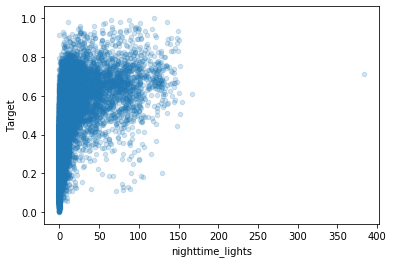

In [ ]:
# Plotting the relationship between an input column and the target
train.plot(x='nighttime_lights', y='Target', kind='scatter', alpha=0.2)

In [ ]:
# Exercise: Try this with different inputs. Any unexpected trends?

As you might have guessed, places that emit more light tend to be wealthier, but there is a lot of variation.

We can also look at categorical columns like 'country' or 'urban_vs_rural' and see the distribution of the target for each group:

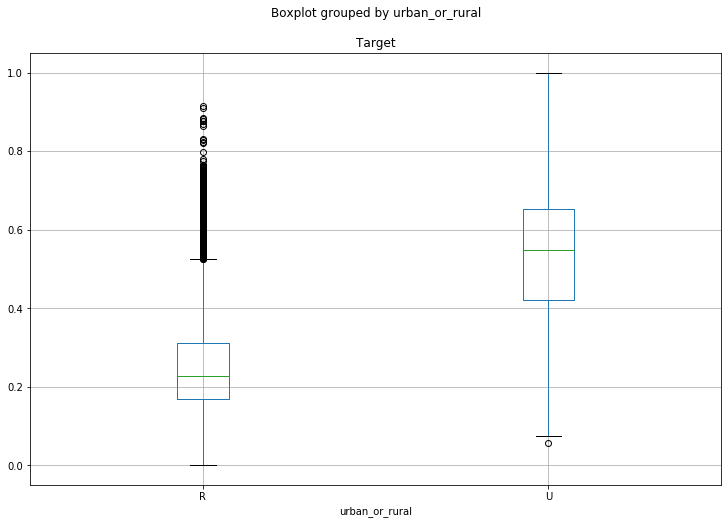

In [ ]:
# Looking at the wealth distribution for urban vs rural
train.boxplot(by='urban_or_rural', column='Target', figsize=(12, 8))

In [ ]:
# Exercise: which is the country with the higest average wealth_index according to this dataset?

Again, not unexpected. Rural areas tend to be less wealthy than urban areas.

Now the scary question: do we have missing data to deal with?

In [ ]:
train.isna().sum() # Hooray - no missing data!

ID                                         0
country                                    0
year                                       0
urban_or_rural                             0
ghsl_water_surface                         0
ghsl_built_pre_1975                        0
ghsl_built_1975_to_1990                    0
ghsl_built_1990_to_2000                    0
ghsl_built_2000_to_2014                    0
ghsl_not_built_up                          0
ghsl_pop_density                           0
landcover_crops_fraction                   0
landcover_urban_fraction                   0
landcover_water_permanent_10km_fraction    0
landcover_water_seasonal_10km_fraction     0
nighttime_lights                           0
dist_to_capital                            0
dist_to_shoreline                          0
Target                                     0
dtype: int64

See what other trends you can uncover - we have only scratched the surface here.

In [ ]:
# Exercise: explore the data further

# My Model JMW


In [ ]:
#Iimport the necessary packages
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split as tts
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn import model_selection


In [ ]:
train_set = pd.read_csv('Train.csv')
train_set.head()
df1=train_set.drop(['ID','country','urban_or_rural'],axis=1)

In [ ]:
import seaborn as sns
hm=train_set.drop(['ID','country','urban_or_rural'],axis=1)
hm.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target
0,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,0.132783
1,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,0.004898
2,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,0.097320
3,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,0.304107
4,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0.605328


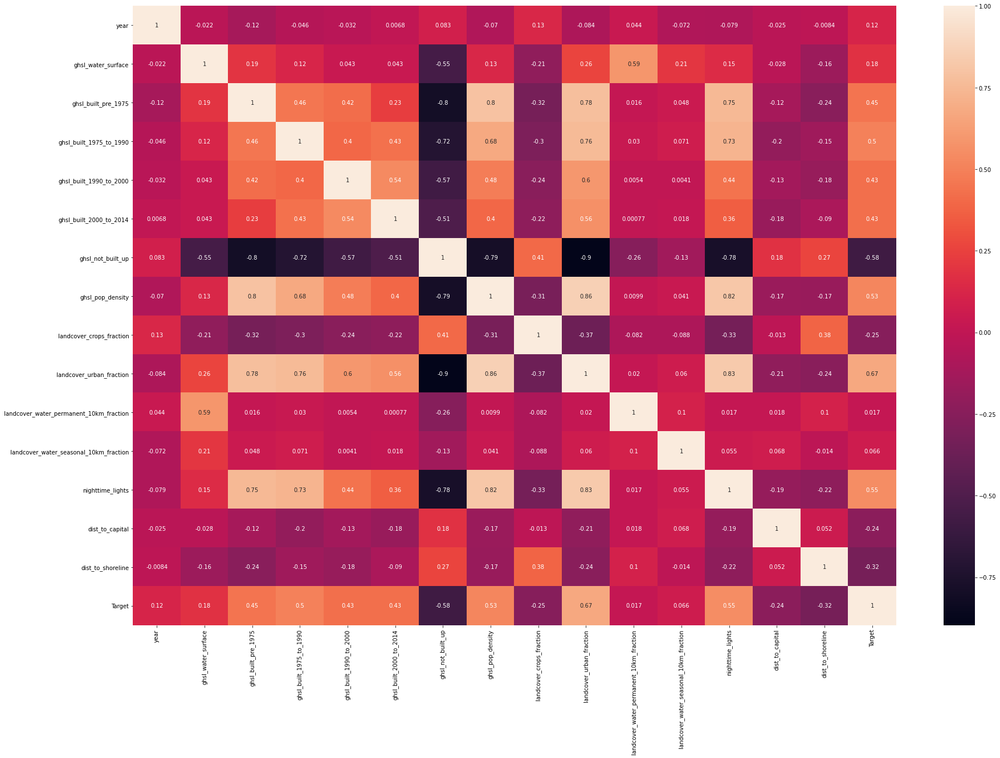

In [ ]:

plt.figure(figsize=(30, 20))
sns.heatmap(hm.corr(),annot=True)
# plt.show()

In [ ]:
a=train_set['country'].unique();a

array(['Ethiopia', 'Mozambique', 'Malawi', 'Guinea', 'Cameroon', 'Ghana',
       'Senegal', 'Kenya', 'Tanzania', 'Mali', 'Swaziland', 'Rwanda',
       'Nigeria', 'Lesotho', 'Sierra Leone', 'Central African Republic',
       "Cote d'Ivoire", 'Togo'], dtype=object)

In [ ]:
test = pd.read_csv('Test.csv')

In [ ]:
frames = [train_set,test]
df_keys = pd.concat(frames, keys=['x', 'y'])
df_keys.head()

ID     country  ...  dist_to_shoreline    Target
x 0  ID_AAIethGy    Ethiopia  ...         769.338378  0.132783
  1  ID_AAYiaCeL    Ethiopia  ...         337.135243  0.004898
  2  ID_AAdurmKj  Mozambique  ...         169.913773  0.097320
  3  ID_AAgNHles      Malawi  ...         613.591610  0.304107
  4  ID_AAishfND      Guinea  ...         192.926363  0.605328

[5 rows x 19 columns]

In [ ]:
Country = pd.get_dummies(df_keys['country']);Country
Urban=pd.get_dummies(df_keys['urban_or_rural']);Urban


R  U
x 0     1  0
  1     1  0
  2     1  0
  3     1  0
  4     0  1
...    .. ..
y 7189  1  0
  7190  0  1
  7191  0  1
  7192  1  0
  7193  0  1

[28648 rows x 2 columns]

In [ ]:
df_new = pd.concat([df_keys, Country,Urban], axis=1)
df7=df_new.drop(['country','urban_or_rural'],axis=1)

In [ ]:
train_set2=df7.loc['x']
train_set2.shape

(21454, 44)

In [ ]:
test=df7.loc['y']
test.shape

(7194, 44)

In [ ]:
train_set.shape

(21454, 19)

In [ ]:
train_set3=train_set2.drop('ID',axis=1)
train_set3.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target,Angola,Benin,Burkina Faso,Cameroon,Central African Republic,Cote d'Ivoire,Democratic Republic of Congo,Ethiopia,Ghana,Guinea,Kenya,Lesotho,Malawi,Mali,Mozambique,Nigeria,Rwanda,Senegal,Sierra Leone,Swaziland,Tanzania,Togo,Uganda,Zambia,Zimbabwe,R,U
0,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,0.132783,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,0.004898,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,0.097320,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,0.304107,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0.605328,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [ ]:
train_set3.dtypes

year                                         int64
ghsl_water_surface                         float64
ghsl_built_pre_1975                        float64
ghsl_built_1975_to_1990                    float64
ghsl_built_1990_to_2000                    float64
ghsl_built_2000_to_2014                    float64
ghsl_not_built_up                          float64
ghsl_pop_density                           float64
landcover_crops_fraction                   float64
landcover_urban_fraction                   float64
landcover_water_permanent_10km_fraction    float64
landcover_water_seasonal_10km_fraction     float64
nighttime_lights                           float64
dist_to_capital                            float64
dist_to_shoreline                          float64
Target                                     float64
Angola                                       uint8
Benin                                        uint8
Burkina Faso                                 uint8
Cameroon                       

In [ ]:
X=train_set3.drop('Target',axis=1);print(X.shape)
y=train_set3['Target']

(21454, 42)


In [ ]:
from sklearn.preprocessing import  StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import KFold
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error,r2_score
from sklearn.model_selection import cross_val_predict
from sklearn.linear_model import LinearRegression
import math

In [ ]:
cv=KFold(n_splits=10,random_state=0,shuffle=False)
cpipeline=make_pipeline(StandardScaler(),KNeighborsRegressor())
ypred=cross_val_predict(cpipeline,X,y,cv=cv)


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_split.py:296: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  FutureWarning


In [ ]:
print('RMSE'+str(round(math.sqrt(mean_squared_error(y,ypred)),2)))

In [ ]:
X.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Angola,Benin,Burkina Faso,Cameroon,Central African Republic,Cote d'Ivoire,Democratic Republic of Congo,Ethiopia,Ghana,Guinea,Kenya,Lesotho,Malawi,Mali,Mozambique,Nigeria,Rwanda,Senegal,Sierra Leone,Swaziland,Tanzania,Togo,Uganda,Zambia,Zimbabwe,R,U
0,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [ ]:
X_train,X_test,y_train,y_test=tts(X,y,test_size=0.3)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(n_estimators=100,
                               bootstrap = True,
                               max_features = 'sqrt')
# Fit on training data
model.fit(X_train, y_train)
model.score(X_train,y_train)

0.9694683758142114

In [ ]:
validation=model_selection.cross_val_score(model,X,y,cv=5)

NameError: ignored

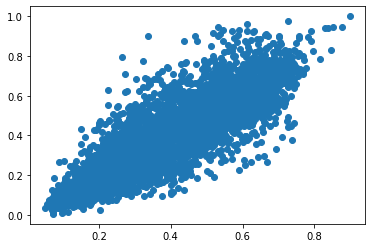

In [ ]:
pred=model.predict(X_test)
plt.scatter(pred,y_test)

In [ ]:
# View accuracy score
errors = abs(pred - y_test)
errors.sum()/len(errors)

0.06611782515194453

In [ ]:
mape = np.mean(100 * (errors / y_test))
mape

24.34327913602409

In [ ]:
round(np.mean(errors), 2)

0.07

In [ ]:
##accuracy
accuracy=100-mape
accuracy

75.6567208639759

In [ ]:
ID=test['ID']

In [ ]:
test1=test.drop(['ID','Target'],axis=1)
test1.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Angola,Benin,Burkina Faso,Cameroon,Central African Republic,Cote d'Ivoire,Democratic Republic of Congo,Ethiopia,Ghana,Guinea,Kenya,Lesotho,Malawi,Mali,Mozambique,Nigeria,Rwanda,Senegal,Sierra Leone,Swaziland,Tanzania,Togo,Uganda,Zambia,Zimbabwe,R,U
0,2007,0.000000,0.000000,0.000000,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.000000,1249.294720,1364.592100,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,2007,0.000000,0.004239,0.000238,0.001227,0.002860,0.991437,6.441547,5.461365,0.452400,0.000000,0.000000,0.000000,821.019579,1046.028681,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,2011,0.007359,0.525682,0.132795,0.095416,0.042375,0.196373,587.516458,2.881811,87.387991,3.248483,3.950374,60.070041,3.620455,906.057334,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1
3,2010,0.000000,0.000089,0.000036,0.001519,0.001358,0.996997,35.141762,33.878927,4.166437,0.000000,0.130727,1.333999,109.493969,775.139189,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,2007,0.000000,0.000138,0.000623,0.000615,0.002961,0.995663,3.442449,33.491994,3.437129,0.133563,0.128997,0.502203,133.643319,835.591501,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0


In [ ]:
Target=model.predict(test1)
Target

array([[0.3059772 ],
       [0.21883814],
       [0.729333  ],
       ...,
       [0.61130655],
       [0.26831442],
       [0.43579113]], dtype=float32)

In [ ]:
test3=test1
test3['ID']=ID
test3['Target']=Target
test3.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Angola,Benin,Burkina Faso,Cameroon,Central African Republic,Cote d'Ivoire,Democratic Republic of Congo,Ethiopia,Ghana,Guinea,Kenya,Lesotho,Malawi,Mali,Mozambique,Nigeria,Rwanda,Senegal,Sierra Leone,Swaziland,Tanzania,Togo,Uganda,Zambia,Zimbabwe,R,U,ID,Target
0,2007,0.000000,0.000000,0.000000,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.000000,1249.294720,1364.592100,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,ID_AAcismbB,0.162050
1,2007,0.000000,0.004239,0.000238,0.001227,0.002860,0.991437,6.441547,5.461365,0.452400,0.000000,0.000000,0.000000,821.019579,1046.028681,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,ID_AAeBMsji,0.246483
2,2011,0.007359,0.525682,0.132795,0.095416,0.042375,0.196373,587.516458,2.881811,87.387991,3.248483,3.950374,60.070041,3.620455,906.057334,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,ID_AAjFMjzy,0.673997
3,2010,0.000000,0.000089,0.000036,0.001519,0.001358,0.996997,35.141762,33.878927,4.166437,0.000000,0.130727,1.333999,109.493969,775.139189,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,ID_AAmMOEEC,0.403964
4,2007,0.000000,0.000138,0.000623,0.000615,0.002961,0.995663,3.442449,33.491994,3.437129,0.133563,0.128997,0.502203,133.643319,835.591501,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,ID_ABguzDxp,0.272279


In [ ]:
sw = test3[['ID', 'Target']];sw.head()

,ID,Target
0,ID_AAcismbB,0.162050
1,ID_AAeBMsji,0.246483
2,ID_AAjFMjzy,0.673997
3,ID_AAmMOEEC,0.403964
4,ID_ABguzDxp,0.272279


In [ ]:
model.predict()

In [ ]:
# lightgbm for regression
from numpy import mean
from numpy import std
from lightgbm import LGBMRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from matplotlib import pyplot
# define dataset

# evaluate the model
model1 = LGBMRegressor()
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)

# fit the model on the whole dataset
model1 = LGBMRegressor()
model1.fit(X_train, y_train)
# make a single prediction
#row = [[2.02220122, 0.31563495, 0.82797464, -0.30620401, 0.16003707, -1.44411381, 0.87616892, -0.50446586, 0.23009474, 0.76201118]]
yhat = model1.predict(X_test)
print('Prediction: %.3f' % yhat[0])

Prediction: 0.284


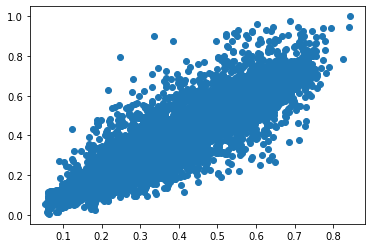

In [ ]:
plt.scatter(yhat,y_test)

In [ ]:
error=abs(yhat-y_test)
mean(error)

0.06368311847649294

In [ ]:
mtest=test1.drop(['ID','Target'],axis=1)

In [ ]:
Target=model1.predict(mtest)

In [ ]:
sub=mtest
sub['ID']=ID
sub['Target']=Target

In [ ]:
sm = sub[['ID', 'Target']];sw.head()

,ID,Target
0,ID_AAcismbB,0.162050
1,ID_AAeBMsji,0.246483
2,ID_AAjFMjzy,0.673997
3,ID_AAmMOEEC,0.403964
4,ID_ABguzDxp,0.272279


In [ ]:
mmm=np.mean(100 * (error / y_test))
print(100-mmm)

76.9744580329559


In [ ]:
##The model that is scaled or standadized doesn't perform well in Random forest regressors

In [ ]:
from sklearn import preprocessing
normalized_X = preprocessing.scale(X_train)
normalized_X2 = preprocessing.scale(X_test)
#normalized_X

In [ ]:
# Fit on training data
model.fit(normalized_X, y_train)
model.score(normalized_X,y_train)

0.8495481711098752

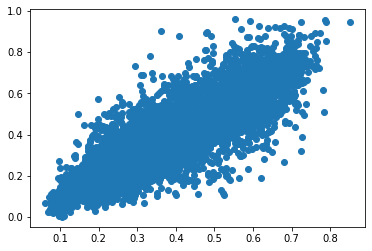

In [ ]:
pred1=model.predict(normalized_X2)
plt.scatter(pred,y_test)

In [ ]:
# View accuracy score
errors1 = abs(pred1 - y_test)

In [ ]:
map = np.mean(100 * (errors1 / y_test))
map

28.848901498339032

In [ ]:
100-map

71.15109850166097

In [ ]:
##Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression as Lr
model=Lr()
model.fit(normalized_X,y_train)
r_sq = model.score(normalized_X, y_train)
r_sq

0.723708934102327

In [ ]:
y_pred = model.predict(normalized_X)

# KERAS

In [ ]:
import tensorflow as tf
from tensorflow.python.keras.layers import Input, Dense
from tensorflow.python import keras
from tensorflow.keras import layers


In [ ]:
def bmodel():
  model=keras.Sequential([layers.Dense(64,activation=tf.nn.relu,input_shape=[len(X_train.keys())]),
                          layers.Dense(64,activation=tf.nn.relu),
                          layers.Dense(1)])
  optimizer=tf.keras.optimizers.RMSprop(0.001)
  model.compile(loss='mse',
                optimizer=optimizer,
                metrics=['mse','mae'])
  return model

In [ ]:
model=bmodel()

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 64)                2752      
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 6,977
Trainable params: 6,977
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Train the model
class PrintDot(keras.callbacks.Callback):
  def epoches(self,epoch,logs):
    if epoch%100==0:
      print('')
      print('.',end='')
Epoch=1000
history=model.fit(X_train,y_train,epochs=Epoch,validation_split=0.2,verbose=0,callbacks=[stops,PrintDot()])

In [ ]:
stops=keras.callbacks.EarlyStopping(monitor='val_loss',patience=10)

In [ ]:
hist=pd.DataFrame(history.history)
hist['epoch']=history.epoch
hist.tail()

,loss,mse,mae,val_loss,val_mse,val_mae,epoch
8,0.010037,0.010037,0.074974,0.010902,0.010902,0.078478,8
9,0.009982,0.009982,0.074640,0.010728,0.010728,0.079013,9
10,0.010013,0.010013,0.075058,0.010261,0.010261,0.075675,10
11,0.009959,0.009959,0.074736,0.010773,0.010773,0.078180,11
12,0.009977,0.009977,0.074734,0.012902,0.012902,0.087533,12


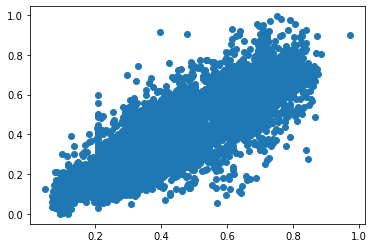

In [ ]:
pred=model.predict(X_test).flatten()
plt.scatter(pred,y_test)

(array([1.000e+00, 0.000e+00, 4.000e+00, 2.000e+00, 3.000e+00, 2.000e+01,
        4.600e+01, 1.010e+02, 1.330e+02, 2.640e+02, 4.970e+02, 8.770e+02,
        1.290e+03, 1.225e+03, 8.260e+02, 5.670e+02, 3.010e+02, 1.340e+02,
        5.900e+01, 4.600e+01, 1.500e+01, 1.000e+01, 6.000e+00, 8.000e+00,
        2.000e+00]),
 array([-0.51768625, -0.47423112, -0.43077599, -0.38732086, -0.34386573,
        -0.3004106 , -0.25695547, -0.21350034, -0.17004521, -0.12659008,
        -0.08313495, -0.03967982,  0.00377531,  0.04723044,  0.09068557,
         0.1341407 ,  0.17759583,  0.22105096,  0.26450609,  0.30796122,
         0.35141635,  0.39487148,  0.43832661,  0.48178174,  0.52523687,
         0.568692  ]),
 <a list of 25 Patch objects>)

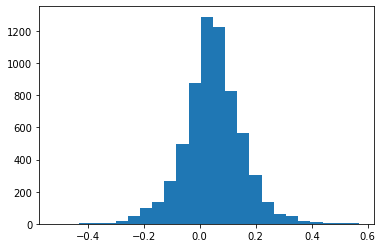

In [ ]:
error=pred-y_test
plt.hist(error,bins=25)

In [ ]:
Target1=model.predict(test1);Target1

array([0.3059772], dtype=float32)

In [ ]:
test5=test1
test5['ID']=ID
test5['Target']=Target1
test5.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Angola,Benin,Burkina Faso,Cameroon,Central African Republic,Cote d'Ivoire,Democratic Republic of Congo,Ethiopia,Ghana,Guinea,Kenya,Lesotho,Malawi,Mali,Mozambique,Nigeria,Rwanda,Senegal,Sierra Leone,Swaziland,Tanzania,Togo,Uganda,Zambia,Zimbabwe,R,U,ID,Target
0,2007,0.000000,0.000000,0.000000,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.000000,1249.294720,1364.592100,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,ID_AAcismbB,0.305977
1,2007,0.000000,0.004239,0.000238,0.001227,0.002860,0.991437,6.441547,5.461365,0.452400,0.000000,0.000000,0.000000,821.019579,1046.028681,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,ID_AAeBMsji,0.218838
2,2011,0.007359,0.525682,0.132795,0.095416,0.042375,0.196373,587.516458,2.881811,87.387991,3.248483,3.950374,60.070041,3.620455,906.057334,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,ID_AAjFMjzy,0.729333
3,2010,0.000000,0.000089,0.000036,0.001519,0.001358,0.996997,35.141762,33.878927,4.166437,0.000000,0.130727,1.333999,109.493969,775.139189,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,ID_AAmMOEEC,0.503114
4,2007,0.000000,0.000138,0.000623,0.000615,0.002961,0.995663,3.442449,33.491994,3.437129,0.133563,0.128997,0.502203,133.643319,835.591501,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,ID_ABguzDxp,0.347303


In [ ]:
dl = test5[['ID', 'Target']];dl.head()

,ID,Target
0,ID_AAcismbB,0.305977
1,ID_AAeBMsji,0.218838
2,ID_AAjFMjzy,0.729333
3,ID_AAmMOEEC,0.503114
4,ID_ABguzDxp,0.347303


# Getting Better

You might have noticed that your score on Zindi wasn't as good as the one you got above. This is because the test set comes from different countries to the train set. When we did a random split, we ended up with our local train and test both coming from the same countries - and it's easier for a model to extrapolate within countries than it is for it to make predictions for a new location.

So our first step might be to make a scoring function that splits the data according to country, and measures the model performance on unseen countries. Try it and share your testing methods in the discussions. And look at the following questions:
- Does your score drop when you score your model on countries it wasn't trained with?
- Does the new score more accurately match the leaderboard score?
- Are any countries particularly 'hard' to make predictions in?

In [ ]:
# You code for a enw model evaluation method here

Knowing how well our model is doing is useful, but however you measure that we also need ways to improve this performance! There are a few ways to do this:

- Feed the model better data. How? Feature engineering! If we can add meaningful features the model will have more data to work with.
- Tune your models. We used the default parameters - perhaps we can tweak some hyperparameters to make our models better
- Try fancier models. Perhaps XGBoost or a neural network is better than Random Forest at this task

Let's do a little of each. First up, let's create a numeric feature that encodes the 'urban_or_rural' column as something the model can use:

In [ ]:
# Turning a categorical column into a numeric feature
train['is_urban'] = (train['urban_or_rural'] == 'U').astype(int)
test['is_urban'] = (test['urban_or_rural'] == 'U').astype(int)
train.head()

,ID,country,year,urban_or_rural,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target,is_urban
0,ID_AAIethGy,Ethiopia,2016,R,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,0.132783,0
1,ID_AAYiaCeL,Ethiopia,2005,R,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,0.004898,0
2,ID_AAdurmKj,Mozambique,2009,R,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,0.097320,0
3,ID_AAgNHles,Malawi,2015,R,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,0.304107,0
4,ID_AAishfND,Guinea,2012,U,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0.605328,1



Note that whenever we add features to train, *we also need to add them to test* otherwise we won't be able to make our predictions.

With this extra feature, we can fit a new model:

In [ ]:
in_cols.append('is_urban') # Adding the new features to our list of input columns

# Replace this with your chosen method for evaluating a model:
X, y = train[in_cols], train['Target']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=58)
model = RandomForestRegressor()
model.fit(X_train, y_train)
mean_squared_error(y_test, model.predict(X_test), squared=False)

NameError: ignored

Did your score improve?

Next, let's tune our model by adjusting the maximum depth. This is one of many hyperparameters that can be tweaked on a Random Forest model. Here I just try a few randomly chosen values, but you could also use a grid search to try values more methodically.

In [ ]:
for max_depth in [3, 5, 8, 10, 14, 18]:
    model = RandomForestRegressor()
    # Again, you van use a better method to evaluate the model here...
    model.fit(X_train, y_train)
    print(max_depth, mean_squared_error(y_test, model.predict(X_test), squared=False))

In this case, it looks like we can improve our performance by specifying a max_depth to limit model complexity.

Finally, let's try a different model out of curiosity:

In [ ]:
from catboost import CatBoostRegressor

model = CatBoostRegressor()
# Exercise: fit and score the model. Does it beat your other scores? Can you use it to make a submission?

**Research:** Extraction of wealth based features from google earth engine

# Pandas Profiling

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
#!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
profile = ProfileReport(train, title="Pandas Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/32 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile2 = ProfileReport(test, title="Pandas Profiling Report 2")
profile2

Summarize dataset:   0%|          | 0/31 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# DS steps

In [ ]:
!pip install catboost

     |████████████████████████████████| 67.3MB 43kB/s 


In [ ]:
#Needed libraries
import numpy as np
from lightgbm import LGBMRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from catboost import CatBoostRegressor
from sklearn.linear_model import LinearRegression

from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split, cross_val_score,RepeatedKFold, GridSearchCV

from sklearn.decomposition import PCA

from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.feature_selection import SelectKBest, f_regression

In [ ]:
train.describe()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target
count,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000,21454.000000
mean,2010.060874,0.028259,0.038222,0.028644,0.012689,0.018386,0.873800,95.756775,21.034265,13.999061,1.486849,0.714891,8.506543,289.722268,402.608539,0.350736
std,4.799579,0.097490,0.113562,0.077367,0.032745,0.040421,0.239294,209.704761,16.751106,23.715485,6.550171,2.383701,21.090378,238.811778,321.517285,0.194376
min,1994.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000859,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.105306,0.112080,0.000000
25%,2008.000000,0.000000,0.000000,0.000000,0.000043,0.000124,0.897867,3.848533,5.610515,0.798841,0.000000,0.001325,0.000000,115.890873,126.379463,0.195772
50%,2011.000000,0.000000,0.000198,0.000709,0.001001,0.001871,0.991919,17.632672,18.509291,2.770159,0.000516,0.029151,0.137333,256.736472,327.271973,0.293574
75%,2014.000000,0.000000,0.007987,0.009868,0.008128,0.014936,0.999532,63.225683,33.590293,12.621501,0.152364,0.381969,4.830194,401.153071,643.910675,0.499003
max,2016.000000,0.969956,0.877116,0.685010,0.515534,0.649159,1.000000,1741.256516,80.064918,98.784092,99.164018,56.201637,382.932769,1897.351575,1769.523906,1.000000


In [ ]:
train.isnull().any()

ID                                         False
country                                    False
year                                       False
urban_or_rural                             False
ghsl_water_surface                         False
ghsl_built_pre_1975                        False
ghsl_built_1975_to_1990                    False
ghsl_built_1990_to_2000                    False
ghsl_built_2000_to_2014                    False
ghsl_not_built_up                          False
ghsl_pop_density                           False
landcover_crops_fraction                   False
landcover_urban_fraction                   False
landcover_water_permanent_10km_fraction    False
landcover_water_seasonal_10km_fraction     False
nighttime_lights                           False
dist_to_capital                            False
dist_to_shoreline                          False
Target                                     False
dtype: bool

In [ ]:
train.duplicated().sum()

0

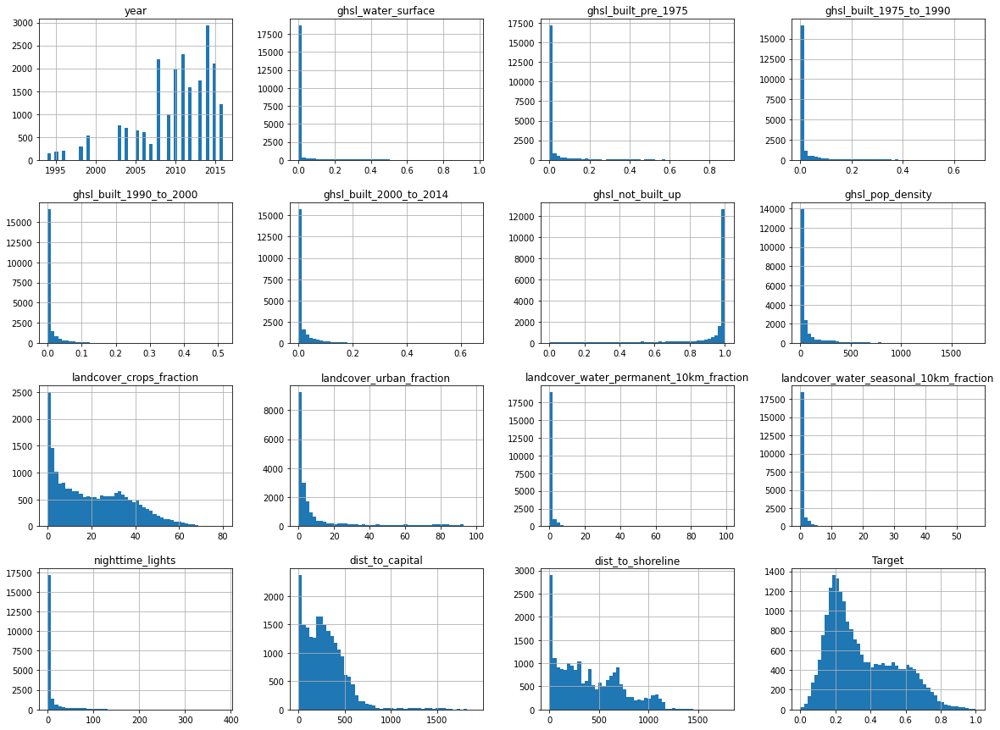

In [ ]:
train.hist(bins=50,figsize=(20,15))
plt.show()

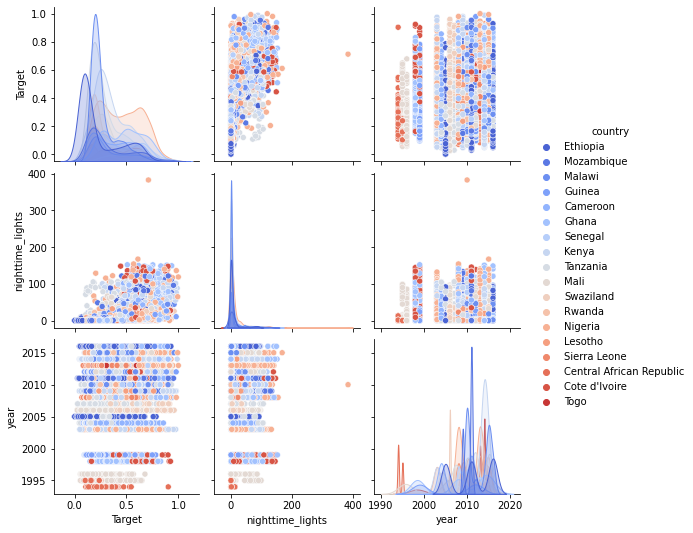

In [ ]:
ax = sns.pairplot(train, hue = 'country', palette ='coolwarm',
                  vars = [ 'Target', 'nighttime_lights', 'year'])

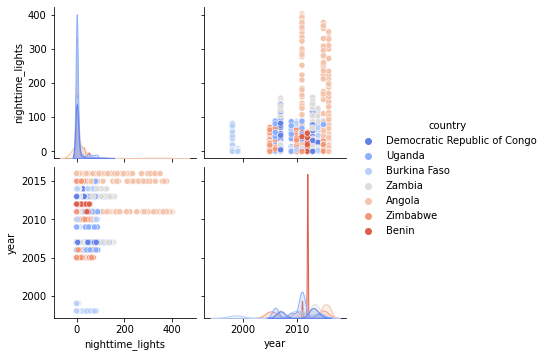

In [ ]:
ax = sns.pairplot(test, hue = 'country', palette ='coolwarm',
                  vars = [ 'nighttime_lights', 'year'])

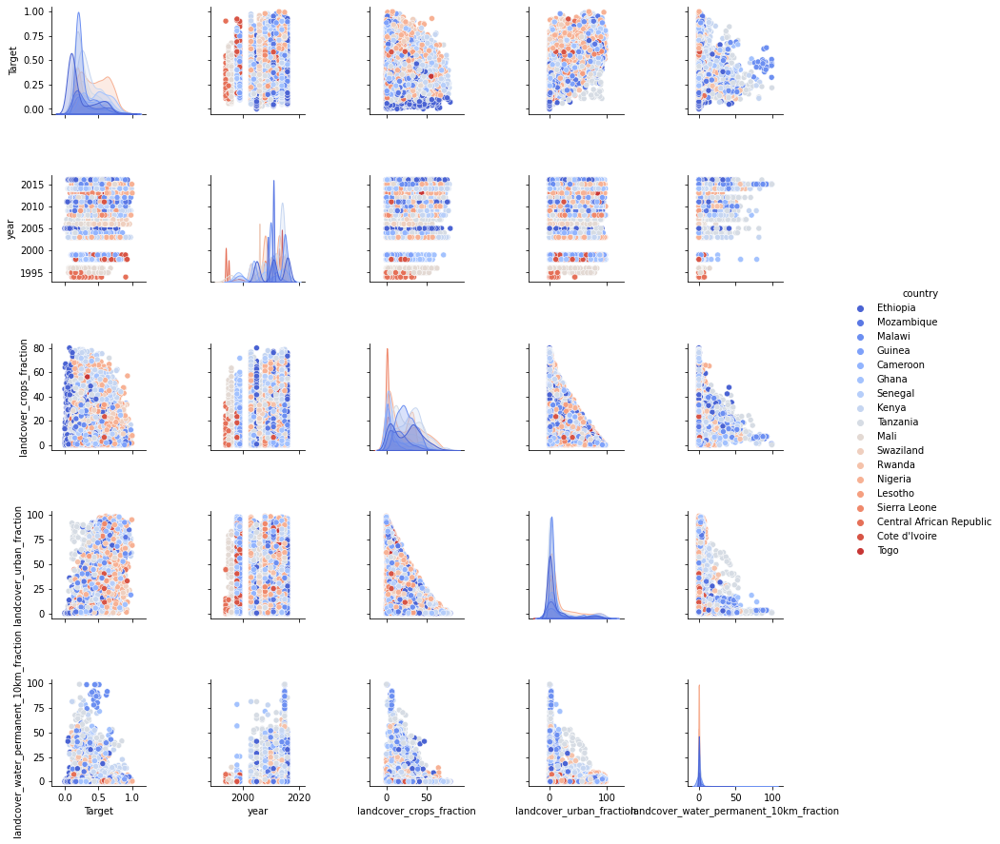

In [ ]:
ax = sns.pairplot(train, hue = 'country', palette ='coolwarm',
                  vars = [ 'Target','year', 'landcover_crops_fraction',
                          'landcover_urban_fraction',
                          'landcover_water_permanent_10km_fraction'])

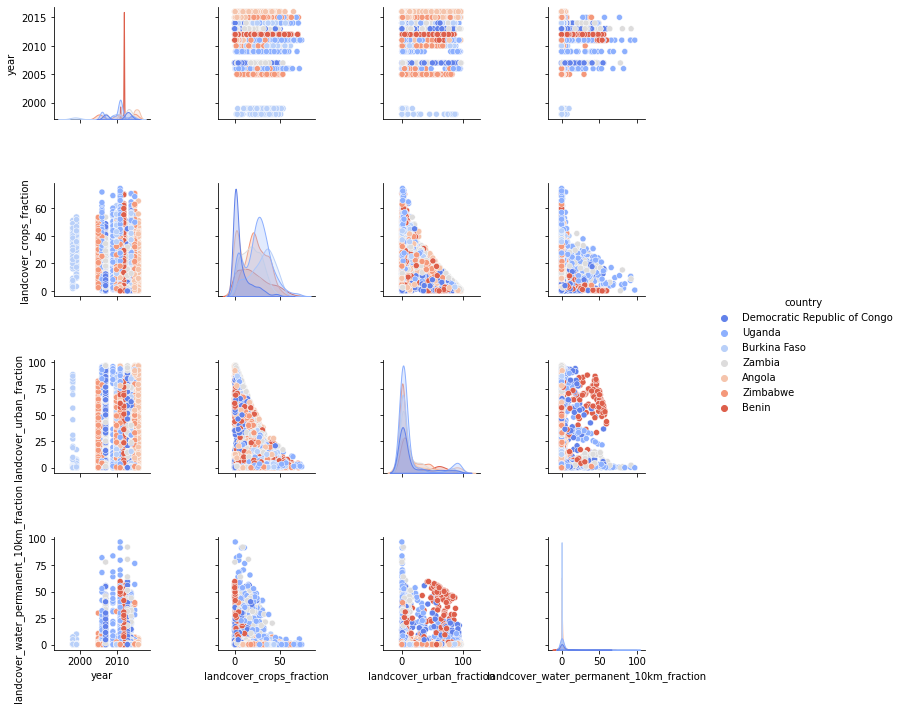

In [ ]:
ax = sns.pairplot(test, hue = 'country', palette ='coolwarm',
                  vars = [ 'year', 'landcover_crops_fraction',
                          'landcover_urban_fraction',
                          'landcover_water_permanent_10km_fraction'])

In [ ]:
train['country'].value_counts()

Nigeria                     2695
Kenya                       2626
Tanzania                    2450
Malawi                      1957
Ethiopia                    1721
Ghana                       1419
Mali                        1295
Cameroon                    1041
Rwanda                       984
Senegal                      903
Mozambique                   879
Lesotho                      794
Sierra Leone                 785
Guinea                       593
Cote d'Ivoire                481
Togo                         330
Swaziland                    270
Central African Republic     231
Name: country, dtype: int64

In [ ]:
test['country'].value_counts()

Uganda                          1584
Zimbabwe                        1189
Zambia                          1038
Burkina Faso                     997
Angola                           855
Democratic Republic of Congo     785
Benin                            746
Name: country, dtype: int64

In [ ]:
cols = ['landcover_crops_fraction','landcover_urban_fraction','landcover_water_permanent_10km_fraction',
        'landcover_water_permanent_10km_fraction','nighttime_lights','dist_to_capital','dist_to_shoreline']

# Check for outliers in the above

In [ ]:
#sns.pairplot(train)

In [ ]:
models ={'Model':['LGBM','Decision tree','Cat boost','Random forest','Ada boost',
                  'Gradient boosting','Extra trees','linear regression'],
         'MSE':[0,0,0,0,0,0,0,0],
         'MAE':[0,0,0,0,0,0,0,0],
         'RMSE':[0,0,0,0,0,0,0,0]}

df_results = pd.DataFrame(models,columns=['Model','MSE','MAE'])

def model_results(model_type, y_test_data, y_pred_data):
  index_val = df_results[df_results['Model']==model_type].index

  df_results.loc[index_val,'MSE']= mean_squared_error(y_test_data, y_pred_data, squared=False)
  df_results.loc[index_val,'MAE']= mean_absolute_error(y_test_data, y_pred_data)
  df_results.loc[index_val,'RMSE']= mean_squared_error(y_test_data, y_pred_data, squared=True)

  return df_results

# Baseline model no addition

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21454 entries, 0 to 21453
Data columns (total 19 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   ID                                       21454 non-null  object 
 1   country                                  21454 non-null  object 
 2   year                                     21454 non-null  int64  
 3   urban_or_rural                           21454 non-null  object 
 4   ghsl_water_surface                       21454 non-null  float64
 5   ghsl_built_pre_1975                      21454 non-null  float64
 6   ghsl_built_1975_to_1990                  21454 non-null  float64
 7   ghsl_built_1990_to_2000                  21454 non-null  float64
 8   ghsl_built_2000_to_2014                  21454 non-null  float64
 9   ghsl_not_built_up                        21454 non-null  float64
 10  ghsl_pop_density                         21454

In [ ]:
train = pd.get_dummies(train, columns=['urban_or_rural'])
train.head(1)

,ID,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target,urban_or_rural_R,urban_or_rural_U
0,ID_AAIethGy,Ethiopia,2016,0.0,0.0,0.0,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.0,0.0,0.0,278.788451,769.338378,0.132783,1,0


In [ ]:
!pip install --upgrade sklearn

Requirement already up-to-date: sklearn in /usr/local/lib/python3.7/dist-packages (0.0)


In [ ]:
#Baby models
def submodels(df1,countries,in_cols):
  for i in countries:
    df = []
    df = df1[df1.country == i]
    X, y = df[in_cols], df['Target']
    try:
      X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
      model = LGBMRegressor()
      model.fit(X_train, y_train)
      print(i,model.score(X_test, y_test),df.shape)
    except ValueError:
      print(i,X.shape)
    y_pred = model.predict(X_test)
  return "I am done"

In [ ]:
train2 = pd.get_dummies(train, columns=['country'])
train2.head(1)

,ID,year,urban_or_rural,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target,country_Cameroon,country_Central African Republic,country_Cote d'Ivoire,country_Ethiopia,country_Ghana,country_Guinea,country_Kenya,country_Lesotho,country_Malawi,country_Mali,country_Mozambique,country_Nigeria,country_Rwanda,country_Senegal,country_Sierra Leone,country_Swaziland,country_Tanzania,country_Togo
0,ID_AAIethGy,2016,R,0.0,0.0,0.0,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.0,0.0,0.0,278.788451,769.338378,0.132783,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
train2.columns

In [ ]:
dcountry1 = train2[['country_Cameroon',
       'country_Central African Republic', "country_Cote d'Ivoire",
       'country_Ethiopia', 'country_Ghana', 'country_Guinea', 'country_Kenya',
       'country_Lesotho', 'country_Malawi', 'country_Mali',
       'country_Mozambique', 'country_Nigeria', 'country_Rwanda',
       'country_Senegal', 'country_Sierra Leone', 'country_Swaziland',
       'country_Tanzania', 'country_Togo']]
dcountry1

,country_Cameroon,country_Central African Republic,country_Cote d'Ivoire,country_Ethiopia,country_Ghana,country_Guinea,country_Kenya,country_Lesotho,country_Malawi,country_Mali,country_Mozambique,country_Nigeria,country_Rwanda,country_Senegal,country_Sierra Leone,country_Swaziland,country_Tanzania,country_Togo
0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21449,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
21450,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
21451,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
21452,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
pca = PCA(n_components=1)
cons = pca.fit_transform(dcountry1)
cons

array([[-0.02503927],
       [-0.02503927],
       [-0.01320939],
       ...,
       [-0.01897232],
       [-0.01897232],
       [-0.01320939]])

In [ ]:
train.shape

(21454, 20)

In [ ]:
train['country1'] = cons[:,0]

In [ ]:
train.head()

,ID,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target,urban_or_rural_R,urban_or_rural_U
0,ID_AAIethGy,Ethiopia,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,0.132783,1,0
1,ID_AAYiaCeL,Ethiopia,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,0.004898,1,0
2,ID_AAdurmKj,Mozambique,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,0.097320,1,0
3,ID_AAgNHles,Malawi,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,0.304107,1,0
4,ID_AAishfND,Guinea,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0.605328,0,1


In [ ]:
in_cols = [ 'ghsl_built_pre_1975',
           'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000',
           'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density',
           'landcover_crops_fraction', 'landcover_urban_fraction',
           'landcover_water_permanent_10km_fraction',
           'landcover_water_seasonal_10km_fraction', 'nighttime_lights',
           'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_U']
print('Input columns:', in_cols)

Input columns: ['ghsl_built_pre_1975', 'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000', 'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density', 'landcover_crops_fraction', 'landcover_urban_fraction', 'landcover_water_permanent_10km_fraction', 'landcover_water_seasonal_10km_fraction', 'nighttime_lights', 'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_U']


In [ ]:
countries = ['Cameroon',
       'Central African Republic', "Cote d'Ivoire",
       'Ethiopia', 'Ghana', 'Guinea', 'Kenya',
       'Lesotho', 'Malawi', 'Mali',
       'Mozambique', 'Nigeria', 'Rwanda',
       'Senegal', 'Sierra Leone', 'Swaziland',
       'Tanzania', 'Togo']

In [ ]:
submodels(train,countries,in_cols)

Cameroon 0.7657900517784383 (1041, 20)
Central African Republic 0.7966013863345202 (231, 20)
Cote d'Ivoire 0.5892377483237716 (481, 20)
Ethiopia 0.8461963532877325 (1721, 20)
Ghana 0.5910474538807275 (1419, 20)
Guinea 0.7031822167549246 (593, 20)
Kenya 0.647349612044233 (2626, 20)
Lesotho 0.4553268635455397 (794, 20)
Malawi 0.5094092261555293 (1957, 20)
Mali 0.5330351572680203 (1295, 20)
Mozambique 0.7978737307819845 (879, 20)
Nigeria 0.669649366445626 (2695, 20)
Rwanda 0.5325059854697718 (984, 20)
Senegal 0.7660022819680448 (903, 20)
Sierra Leone 0.8338435840208831 (785, 20)
Swaziland 0.38497431272852023 (270, 20)
Tanzania 0.5434518983253371 (2450, 20)
Togo 0.8610921299509705 (330, 20)


'I am done'

In [ ]:
countries2 = ['Angola', 'Benin','Burkina Faso', 'Democratic Republic of Congo',
       'Uganda', 'Zambia', 'Zimbabwe']

In [ ]:
for i in countries:
  print(train[train.country == i].shape)

(1041, 20)
(231, 20)
(481, 20)
(1721, 20)
(1419, 20)
(593, 20)
(2626, 20)
(794, 20)
(1957, 20)
(1295, 20)
(879, 20)
(2695, 20)
(984, 20)
(903, 20)
(785, 20)
(270, 20)
(2450, 20)
(330, 20)


In [ ]:
train.shape

(21454, 20)

In [ ]:
X, y = train[in_cols], train['Target']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) # Random state keeps the split consistent
print(X_train.shape, X_test.shape)

(17163, 14) (4291, 14)


In [ ]:
X_train.head(1)

,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_U
1686,0.56779,0.280459,0.01621,0.000247,0.135294,898.932608,1.152296,90.050397,0.004618,0.012989,98.912628,1.979306,191.637927,1


In [ ]:
#!pip install lightgbm

In [ ]:
?LGBMRegressor?

In [ ]:
# fit the model on the whole dataset
#model = LGBMRegressor(n_estimators=80,num_leaves=50)
model = LGBMRegressor()
model.fit(X_train, y_train)
print(model.score(X_test, y_test))

# The `squared=False` bit tells this function to return the ROOT mean squared error
#mean_squared_error(y_test, model.predict(X_test), squared=False)
y_pred = model.predict(X_test)

0.7083112147362363


In [ ]:
model_results('LGBM',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.103983,0.077176,0.010812
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.104347,0.077391,0.010888
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.122565,0.099991,0.015022
5,Gradient boosting,0.108738,0.082106,0.011824
6,Extra trees,0.107678,0.078863,0.011595
7,linear regression,0.124000,0.095193,0.015376


In [ ]:
# Get numerical feature importances
importances = list(model.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 3)) for feature, importance in zip(in_cols, importances)]

# Sort the values in descending order, to observe most important features first.
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: dist_to_shoreline    Importance: 530
Variable: dist_to_capital      Importance: 471
Variable: landcover_crops_fraction Importance: 381
Variable: landcover_urban_fraction Importance: 322
Variable: nighttime_lights     Importance: 316
Variable: landcover_water_seasonal_10km_fraction Importance: 272
Variable: ghsl_pop_density     Importance: 257
Variable: ghsl_built_1975_to_1990 Importance: 250
Variable: ghsl_built_2000_to_2014 Importance: 218
Variable: ghsl_built_1990_to_2000 Importance: 210
Variable: ghsl_built_pre_1975  Importance: 192
Variable: landcover_water_permanent_10km_fraction Importance: 178
Variable: ghsl_not_built_up    Importance: 167
Variable: urban_or_rural_U     Importance: 80
Variable: ghsl_water_surface   Importance: 76


In [ ]:
?model.feature_importances_

In [ ]:
# fit the model on the whole dataset
model = DecisionTreeRegressor()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('Decision tree',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.000000,0.000000,NaN
3,Random forest,0.000000,0.000000,NaN
4,Ada boost,0.000000,0.000000,NaN
5,Gradient boosting,0.000000,0.000000,NaN
6,Extra trees,0.000000,0.000000,NaN
7,linear regression,0.000000,0.000000,NaN


In [ ]:
from sklearn.model_selection import GridSearchCV
parameters = {'boosting_type' : ['gbdt','dart','goss'],
              'learning_rate':[0.1,0.09,0.12,0.11]
              }

grid = GridSearchCV(estimator=model, param_grid = parameters, cv = 2, n_jobs=-1)

In [ ]:
grid.fit(X_train, y_train)

GridSearchCV(cv=2, error_score=nan,
             estimator=LGBMRegressor(boosting_type='gbdt', class_weight=None,
                                     colsample_bytree=1.0,
                                     importance_type='split', learning_rate=0.1,
                                     max_depth=-1, min_child_samples=20,
                                     min_child_weight=0.001, min_split_gain=0.0,
                                     n_estimators=80, n_jobs=-1, num_leaves=50,
                                     objective='Regression', random_state=None,
                                     reg_alpha=0.0, reg_lambda=0.0, silent=True,
                                     subsample=1.0, subsample_for_bin=200000,
                                     subsample_freq=0),
             iid='deprecated', n_jobs=-1,
             param_grid={'boosting_type': ['gbdt', 'dart', 'goss'],
                         'learning_rate': [0.1, 0.09, 0.12, 0.11]},
             pre_dispatch='2*n_jobs', r

In [ ]:
print(" Results from Grid Search " )
print("\n The best estimator across ALL searched params:\n", grid.best_estimator_)
print("\n The best score across ALL searched params:\n", grid.best_score_)
print("\n The best parameters across ALL searched params:\n", grid.best_params_)

 Results from Grid Search 

 The best estimator across ALL searched params:
 LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.11, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=80, n_jobs=-1, num_leaves=50, objective='Regression',
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

 The best score across ALL searched params:
 0.7194344348498304

 The best parameters across ALL searched params:
 {'boosting_type': 'gbdt', 'learning_rate': 0.11}


In [ ]:
# fit the model on the whole dataset
model = CatBoostRegressor(depth= 10, iterations = 200, verbose=False)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('Cat boost',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.104347,0.077391,0.010888
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.122565,0.099991,0.015022
5,Gradient boosting,0.108738,0.082106,0.011824
6,Extra trees,0.107678,0.078863,0.011595
7,linear regression,0.124000,0.095193,0.015376


In [ ]:
# fit the model on the whole dataset
model = RandomForestRegressor()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('Random forest',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.103593,0.077013,0.010731
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.000000,0.000000,NaN
5,Gradient boosting,0.000000,0.000000,NaN
6,Extra trees,0.000000,0.000000,NaN
7,linear regression,0.000000,0.000000,NaN


In [ ]:
# fit the model on the whole dataset
model = AdaBoostRegressor()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('Ada boost',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.103593,0.077013,0.010731
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.122565,0.099991,0.015022
5,Gradient boosting,0.000000,0.000000,NaN
6,Extra trees,0.000000,0.000000,NaN
7,linear regression,0.000000,0.000000,NaN


In [ ]:
# fit the model on the whole dataset
model = GradientBoostingRegressor()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('Gradient boosting',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.103593,0.077013,0.010731
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.122565,0.099991,0.015022
5,Gradient boosting,0.108738,0.082106,0.011824
6,Extra trees,0.000000,0.000000,NaN
7,linear regression,0.000000,0.000000,NaN


In [ ]:
# fit the model on the whole dataset
model = ExtraTreesRegressor()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('Extra trees',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.103593,0.077013,0.010731
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.122565,0.099991,0.015022
5,Gradient boosting,0.108738,0.082106,0.011824
6,Extra trees,0.107678,0.078863,0.011595
7,linear regression,0.000000,0.000000,NaN


In [ ]:
# fit the model on the whole dataset
model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
model_results('linear regression',y_test,y_pred)

,Model,MSE,MAE,RMSE
0,LGBM,0.104064,0.077662,0.010829
1,Decision tree,0.142383,0.104397,0.020273
2,Cat boost,0.103593,0.077013,0.010731
3,Random forest,0.104704,0.077372,0.010963
4,Ada boost,0.122565,0.099991,0.015022
5,Gradient boosting,0.108738,0.082106,0.011824
6,Extra trees,0.107678,0.078863,0.011595
7,linear regression,0.124000,0.095193,0.015376


In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
print('MAE: %.3f (%.3f)' % (np.mean(n_scores), np.std(n_scores)))


MAE: -0.077 (0.002)


In [ ]:
model.predict(X_test)

array([0.28752393, 0.22897108, 0.28311489, ..., 0.23387207, 0.26156379,
       0.4854425 ])

# Baseline model

In [ ]:
#Uncomment and run if you have not run the baseline model no addition cells

train = pd.get_dummies(train, columns=['urban_or_rural'])
train.head(1)

,ID,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target,urban_or_rural_R,urban_or_rural_U
0,ID_AAIethGy,Ethiopia,2016,0.0,0.0,0.0,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.0,0.0,0.0,278.788451,769.338378,0.132783,1,0


In [ ]:
gdp = pd.read_csv("gdp.csv")

In [ ]:
cntry=gdp['Country'].to_list()
#cntry

In [ ]:
#for country in train['country']:
def gdpc(country):
  ind=cntry.index(country)
  if ind <7:
    return 1
  elif ind<31:
    return 2
  # elif ind<33:
  #   return 3
  # elif ind<44:
  #   return 4
  else:
    return 3

train['gdp'] = train['country'].apply(gdpc)

In [ ]:
train.sample(3)

,ID,country,year,urban_or_rural,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,Target
20785,ID_yVDTIVOC,Mali,1995,U,0.020221,0.094344,0.297938,0.018290,0.170103,0.399103,534.778609,7.018169,66.183003,1.918822,3.710288,44.679088,9.960015,692.879745,0.536941
1773,ID_EImjcUyZ,Guinea,2012,R,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,5.315644,0.213005,0.000000,0.065129,0.000000,329.772470,276.632678,0.204577
17568,ID_qkvLEVti,Malawi,2010,R,0.000000,0.000000,0.000240,0.000137,0.000034,0.999588,5.567156,46.504436,0.610131,0.000000,0.000000,0.000000,369.589536,214.814199,0.104326


In [ ]:
in_cols = ['ghsl_built_pre_1975',
           'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000',
           'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density',
           'landcover_urban_fraction', 'nighttime_lights', 'urban_or_rural_R',
           'urban_or_rural_U']
print('Input columns:', in_cols)

Input columns: ['ghsl_built_pre_1975', 'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000', 'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density', 'landcover_urban_fraction', 'nighttime_lights', 'urban_or_rural_R', 'urban_or_rural_U']


In [ ]:
X, y = train[in_cols], train['Target']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=58) # Random state keeps the split consistent
print(X_train.shape, X_test.shape)

(17163, 10) (4291, 10)


In [ ]:
X_train.head(1)

,ghsl_built_1975_to_1990,landcover_crops_fraction,landcover_urban_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,gdp
12831,0.0,0.581952,0.107568,0.0,358.678881,15.627517,2


In [ ]:
#!pip install lightgbm

In [ ]:
# fit the model on the whole dataset
model = LGBMRegressor()
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.6860229651596583

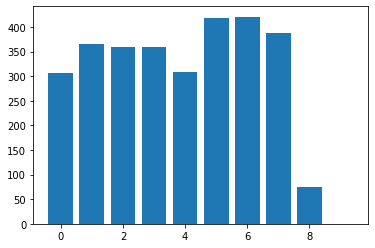

In [ ]:
# get importance
importance = model.feature_importances_
# summarize feature importance

plt.bar([x for x in range(len(importance))], importance)
plt.show()

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
print('MAE: %.3f (%.3f)' % (np.mean(n_scores), np.std(n_scores)))


MAE: -0.075 (0.002)


In [ ]:
model.predict(X_test)

array([0.2500085 , 0.20883964, 0.30915339, ..., 0.24949447, 0.26144471,
       0.47277719])

In [ ]:
# The `squared=False` bit tells this function to return the ROOT mean squared error
mean_squared_error(y_test, model.predict(X_test), squared=False)

0.1104087064188834

# Hyperparameter tuning, grid search

In [ ]:
# evaluate the model
model = LGBMRegressor()

In [ ]:
LGBMRegressor?

In [ ]:
grid_param = {
    'boosting_type':['gbdt','dart','goss','rf'],
    'num_leaves':[25,30,31,35,40,50],
    'max_depth': [-1,-2,-3],
    'n_estimators':[100,200, 300,400, 500],
    'learning_rate': [0.05,0.08, 0.09, 0.1, 0.2]
}

In [ ]:
#Grid search
gd_sr = GridSearchCV(model, param_grid=grid_param,
                     cv=5,
                     n_jobs=-1)

In [ ]:
GridSearchCV?

In [ ]:
gd_sr.fit(X_train, y_train)
gd_sr.score(X_test,y_test)

0.6857104186499198

In [ ]:
mean_squared_error(y_test, gd_sr.predict(X_test), squared=False)df1 = df[['a', 'b']]

0.10299977335189449

In [ ]:
gd_sr.predict(X_test)

array([0.28192233, 0.22775631, 0.2857615 , ..., 0.23302219, 0.26918747,
       0.48418174])

# Dimensionality reduction

In [ ]:
pca = PCA(n_components=3)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

# Running model on test set

In [ ]:
test = pd.get_dummies(test, columns=['urban_or_rural'])
test.head(1)

,ID,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U
0,ID_AAcismbB,Democratic Republic of Congo,2007,0.0,0.0,0.0,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.0,1249.29472,1364.5921,1,0


In [ ]:
test.head(1)

,ID,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U
0,ID_AAcismbB,Democratic Republic of Congo,2007,0.0,0.0,0.0,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.0,1249.29472,1364.5921,1,0


In [ ]:
test2 = pd.get_dummies(test, columns=['country'])
test2.head(1)

,ID,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U,country_Angola,country_Benin,country_Burkina Faso,country_Democratic Republic of Congo,country_Uganda,country_Zambia,country_Zimbabwe
0,ID_AAcismbB,2007,0.0,0.0,0.0,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.0,1249.29472,1364.5921,1,0,0,0,0,1,0,0,0


In [ ]:
test2.columns

Index(['ID', 'year', 'ghsl_water_surface', 'ghsl_built_pre_1975',
       'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000',
       'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density',
       'landcover_crops_fraction', 'landcover_urban_fraction',
       'landcover_water_permanent_10km_fraction',
       'landcover_water_seasonal_10km_fraction', 'nighttime_lights',
       'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_R',
       'urban_or_rural_U', 'country_Angola', 'country_Benin',
       'country_Burkina Faso', 'country_Democratic Republic of Congo',
       'country_Uganda', 'country_Zambia', 'country_Zimbabwe'],
      dtype='object')

In [ ]:
dcountry2 = test2[['country_Angola', 'country_Benin',
       'country_Burkina Faso', 'country_Democratic Republic of Congo',
       'country_Uganda', 'country_Zambia', 'country_Zimbabwe']]
dcountry2

,country_Angola,country_Benin,country_Burkina Faso,country_Democratic Republic of Congo,country_Uganda,country_Zambia,country_Zimbabwe
0,0,0,0,1,0,0,0
1,0,0,0,1,0,0,0
2,0,0,0,0,1,0,0
3,0,0,1,0,0,0,0
4,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...
7189,0,0,0,0,0,0,1
7190,0,0,0,0,1,0,0
7191,0,0,1,0,0,0,0
7192,0,0,0,0,0,0,1


In [ ]:
pca = PCA(n_components=1)
cons = pca.fit_transform(dcountry2)
cons[:,0]

array([-0.15509621, -0.15509621,  0.83520025, ..., -0.22628687,
       -0.38728315, -0.15509621])

In [ ]:
test['country1'] = cons[:,0]

In [ ]:
test['gdp'] = test['country'].apply(gdpc)

In [ ]:
X_train.columns

Index(['ghsl_built_pre_1975', 'ghsl_built_1975_to_1990',
       'ghsl_built_1990_to_2000', 'ghsl_built_2000_to_2014',
       'ghsl_not_built_up', 'ghsl_pop_density', 'landcover_crops_fraction',
       'landcover_urban_fraction', 'landcover_water_permanent_10km_fraction',
       'landcover_water_seasonal_10km_fraction', 'nighttime_lights',
       'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_U'],
      dtype='object')

In [ ]:
vr = ['ghsl_built_pre_1975', 'ghsl_built_1975_to_1990',
       'ghsl_built_1990_to_2000', 'ghsl_built_2000_to_2014',
       'ghsl_not_built_up', 'ghsl_pop_density', 'landcover_crops_fraction',
       'landcover_urban_fraction', 'landcover_water_permanent_10km_fraction',
       'landcover_water_seasonal_10km_fraction', 'nighttime_lights',
       'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_U']

In [ ]:
#Performing PCA
ts = pca.transform(test[vr])

In [ ]:
ss['Target'] = model.predict(test[vr])
ss.head()

,ID,Target
0,ID_AAcismbB,0.160641
1,ID_AAeBMsji,0.190093
2,ID_AAjFMjzy,0.591084
3,ID_AAmMOEEC,0.409626
4,ID_ABguzDxp,0.271424


In [ ]:
# ss['Target']=gd_sr.predict(test[vr])
# ss.head()

In [ ]:
#sw.to_csv('submission_8.csv',index=False)
#sm.to_csv('submission_9.csv',index=False)
#dl.to_csv('submission 13.csv',index=False)
#ss.to_csv('submission_15.csv',index=False)#Random forest
# ss.to_csv('submission_16.csv',index=False)# goss on LGBM
# ss.to_csv('submission_17.csv',index=False)# numleaves 50 on LGBM
#ss.to_csv('submission_18.csv',index=False)# nestimators 180 on LGBM
#ss.to_csv('submission_19.csv',index=False)# nestimators 180 + numleaves 50 on LGBM
#ss.to_csv('submission_20.csv',index=False)# nestimators 150 + numleaves 50 on LGBM
# ss.to_csv('submission_21.csv',index=False)# nestimators 130 + numleaves 50 on LGBM
# ss.to_csv('submission_22.csv',index=False)# nestimators 80 + numleaves 50 on LGBM
# ss.to_csv('submission_23.csv',index=False)# nestimators 50 + numleaves 50 on LGBM
# ss.to_csv('submission_24.csv',index=False)# nestimators 90 + numleaves 50 on LGBM
#ss.to_csv('submission_25.csv',index=False)# nestimators 85 + numleaves 50 on LGBM
#ss.to_csv('submission_26.csv',index=False)# catboost
#ss.to_csv('submission_27.csv',index=False)# nestimators 80 + numleaves 50 on LGBM with yr
#ss.to_csv('submission_28.csv',index=False)# 2 pca on country nestimators 80 + numleaves 50 on LGBM
#ss.to_csv('submission_29.csv',index=False)# 1 pca on country nestimators 80 + numleaves 50 on LGBM
#ss.to_csv('submission_30.csv',index=False)# 1 pca on country baseline LGBM
#ss.to_csv('submission_31.csv',index=False)# 1 pca on country baseline catboost
#ss.to_csv('submission_32.csv',index=False)# catboost 10 depth, 200 iterations
#ss.to_csv('submission_33.csv',index=False)# nestimators 79 + numleaves 50 on LGBM
#ss.to_csv('submission_34.csv',index=False)# nestimators 79 + numleaves 50 on LGBM,0.11 learning rate
#ss.to_csv('submission_35.csv',index=False)# nestimators 80 + numleaves 50 on LGBM, -distshoreline
#ss.to_csv('submission_36.csv',index=False)# nestimators 79 + numleaves 50 on LGBM -gsls built up
#ss.to_csv('submission_37.csv',index=False)# nestimators 79 + numleaves 50 on LGBM - regress
ss.to_csv('submission_38.csv',index=False)# nestimators 79 + numleaves 50 on LGBM - water surface

In [ ]:
df = pd.read_csv("my_crazy_1.csv")

In [ ]:
df.head()

,Unnamed: 0,ID,Target
0,0,ID_AAcismbB,0.195404
1,1,ID_AAeBMsji,0.219018
2,2,ID_AAjFMjzy,0.591906
3,3,ID_AAmMOEEC,0.376883
4,4,ID_ABguzDxp,0.131271


In [ ]:
df.drop("Unnamed: 0",inplace=True,axis=1)

In [ ]:
df.shape

(7194, 2)

In [ ]:
ss.shape

(7194, 2)

In [ ]:
df.to_csv('craziness.csv',index=False)

# Clustering

In [ ]:
df = train.drop(["ID","Target","country1"],axis=1)

In [ ]:
df.head(1)

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U
0,Ethiopia,2016,0.0,0.0,0.0,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.0,0.0,0.0,278.788451,769.338378,1,0


In [ ]:
Target=train['Target']

In [ ]:
df.shape

(21454, 18)

In [ ]:
Id=test['ID']

In [ ]:
df2 = test.drop(["ID","country1"],axis=1)

In [ ]:
df2.head(1)

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U
0,Democratic Republic of Congo,2007,0.0,0.0,0.0,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.0,1249.29472,1364.5921,1,0


In [ ]:
df2.shape

(7194, 18)

In [ ]:
clust = pd.concat([df,df2])

In [ ]:
clust.head(1)

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U
0,Ethiopia,2016,0.0,0.0,0.0,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.0,0.0,0.0,278.788451,769.338378,1,0


In [ ]:
clust.shape

(28648, 18)

In [ ]:
len(clust['country'].unique())

25

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
labelencoder = LabelEncoder()
clust["country_cat"] = labelencoder.fit_transform(clust['country'])
clust.head()

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U,country_cat
0,Ethiopia,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,1,0,7
1,Ethiopia,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,1,0,7
2,Mozambique,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,1,0,14
3,Malawi,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,1,0,12
4,Guinea,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0,1,9


In [ ]:
!pip install kneed

In [ ]:
from kneed import KneeLocator
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [ ]:
kmeans = KMeans(init="random",
                n_clusters=5,
                n_init=10,
                max_iter=300,
                random_state=42)

In [ ]:
label = kmeans.fit_predict(clust.drop('country',axis=1))

In [ ]:
kmeans_silhouette = silhouette_score(clust.drop('country',axis=1), kmeans.labels_).round(2)

In [ ]:
clust['label'] = label

In [ ]:
kmeans_silhouette

0.34

In [ ]:
clust.head(10)

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U,country_cat,label
0,Ethiopia,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,1,0,7,0
1,Ethiopia,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,1,0,7,4
2,Mozambique,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,1,0,14,4
3,Malawi,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,1,0,12,0
4,Guinea,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0,1,9,4
5,Ethiopia,2016,0.0,0.008623,0.019409,0.059886,0.082682,0.829400,203.580507,24.629433,31.235708,0.000000,0.008223,22.981970,9.803702,487.790852,0,1,7,0
6,Cameroon,2004,0.0,0.000131,0.000149,0.000168,0.000093,0.999458,0.342950,0.011798,0.251395,0.000000,0.000289,0.000000,290.621111,477.563353,1,0,3,0
7,Ghana,2014,0.0,0.001298,0.001042,0.000219,0.000347,0.997094,14.340860,42.594576,4.180947,0.011511,0.112440,0.000000,438.103890,435.816271,1,0,8,0
8,Senegal,2010,0.0,0.000000,0.000751,0.001485,0.000035,0.997729,19.468199,11.332716,2.191206,0.410365,4.746894,0.528963,482.262914,320.867328,0,1,17,4
9,Ethiopia,2016,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.105011,0.147196,0.000000,0.230172,0.000000,533.139137,1016.580304,1,0,7,1


In [ ]:
clust.groupby('label')['country'].count()

label
0     8740
1     5372
2     1632
3     1542
4    11362
Name: country, dtype: int64

In [ ]:
df5=clust[:21454]
df5.head()

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U,country_cat,label
0,Ethiopia,2016,0.0,0.000000,0.000000,0.000055,0.000536,0.999408,12.146134,25.489659,0.879484,0.000000,0.000000,0.000000,278.788451,769.338378,1,0,7,0
1,Ethiopia,2005,0.0,0.000000,0.000110,0.000000,0.000018,0.999872,113.806716,64.136053,0.601427,0.000000,0.005427,0.000000,200.986978,337.135243,1,0,7,4
2,Mozambique,2009,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.400096,0.131900,0.000000,0.003078,0.000000,642.594208,169.913773,1,0,14,4
3,Malawi,2015,0.0,0.000141,0.000181,0.000254,0.000228,0.999195,5.213320,25.379371,2.017136,11.293841,0.131035,0.000000,365.349451,613.591610,1,0,12,0
4,Guinea,2012,0.0,0.011649,0.017560,0.017383,0.099875,0.853533,31.734661,5.081620,22.815984,0.005047,0.130475,1.461894,222.867189,192.926363,0,1,9,4


In [ ]:
df5['Target']=Target

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df5.shape

(21454, 20)

In [ ]:
df6=clust[21454:]
df6.head()

,country,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U,country_cat,label
0,Democratic Republic of Congo,2007,0.000000,0.000000,0.000000,0.000523,0.000131,0.999347,0.660758,0.990942,0.132264,0.069055,0.032627,0.000000,1249.294720,1364.592100,1,0,6,3
1,Democratic Republic of Congo,2007,0.000000,0.004239,0.000238,0.001227,0.002860,0.991437,6.441547,5.461365,0.452400,0.000000,0.000000,0.000000,821.019579,1046.028681,0,1,6,3
2,Uganda,2011,0.007359,0.525682,0.132795,0.095416,0.042375,0.196373,587.516458,2.881811,87.387991,3.248483,3.950374,60.070041,3.620455,906.057334,0,1,22,1
3,Burkina Faso,2010,0.000000,0.000089,0.000036,0.001519,0.001358,0.996997,35.141762,33.878927,4.166437,0.000000,0.130727,1.333999,109.493969,775.139189,0,1,2,1
4,Zambia,2007,0.000000,0.000138,0.000623,0.000615,0.002961,0.995663,3.442449,33.491994,3.437129,0.133563,0.128997,0.502203,133.643319,835.591501,1,0,23,1


In [ ]:
X=df5.drop(['Target','country'],axis=1)
y=df5['Target']

In [ ]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25)

In [ ]:
X_train.head()

,year,ghsl_water_surface,ghsl_built_pre_1975,ghsl_built_1975_to_1990,ghsl_built_1990_to_2000,ghsl_built_2000_to_2014,ghsl_not_built_up,ghsl_pop_density,landcover_crops_fraction,landcover_urban_fraction,landcover_water_permanent_10km_fraction,landcover_water_seasonal_10km_fraction,nighttime_lights,dist_to_capital,dist_to_shoreline,urban_or_rural_R,urban_or_rural_U,country_cat,label
12397,2010,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,14.805231,0.636757,0.291651,2.993874,0.011456,188.095528,38.765980,1,0,17,4
474,2013,0.0,0.000110,0.000018,0.000092,0.000037,0.999742,1.361924,0.451600,0.249452,0.000000,0.000000,0.000000,112.846871,64.799279,1,0,18,4
10323,2014,0.0,0.003737,0.006104,0.003305,0.009785,0.977069,118.166552,31.260227,15.803478,0.000000,0.002604,4.608634,288.927693,692.864603,0,1,10,0
11799,2012,0.0,0.000037,0.000056,0.000019,0.000093,0.999796,3.743811,41.205568,3.696318,0.000000,0.073097,0.000000,1.200794,338.928244,1,0,20,4
19604,2013,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,3.925945,0.099314,0.000000,0.002818,0.000000,602.403184,340.043016,1,0,17,4


In [ ]:
y_train.shape

(16090,)

In [ ]:
model = LGBMRegressor()
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.7976219775805337

In [ ]:
df7=df6.drop('country',axis=1)
df7.shape

(7194, 19)

In [ ]:
T=model.predict(df7)
T.shape

(7194,)

In [ ]:
DATA={"ID":Id,
      'Target':T}

In [ ]:
subs=pd.DataFrame(DATA)

In [ ]:
subs.to_csv('submissionme.csv',index=False)

# Feature importances

In [ ]:
!pip install catboost

In [ ]:
#Needed libraries
import numpy as np
from lightgbm import LGBMRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from catboost import CatBoostRegressor
from sklearn.linear_model import LinearRegression

from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split, cross_val_score,RepeatedKFold, GridSearchCV

from sklearn.decomposition import PCA

from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.feature_selection import SelectKBest, f_regression

In [ ]:
train = pd.get_dummies(train, columns=['urban_or_rural'])
train.head(1)

In [ ]:
in_cols = ['ghsl_water_surface', 'ghsl_built_pre_1975',
           'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000',
           'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density',
           'landcover_crops_fraction', 'landcover_urban_fraction',
           'landcover_water_permanent_10km_fraction',
           'landcover_water_seasonal_10km_fraction', 'nighttime_lights',
           'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_U']
print('Input columns:', in_cols)

Input columns: ['ghsl_built_pre_1975', 'ghsl_built_1975_to_1990', 'ghsl_built_1990_to_2000', 'ghsl_built_2000_to_2014', 'ghsl_not_built_up', 'ghsl_pop_density', 'landcover_crops_fraction', 'landcover_urban_fraction', 'landcover_water_permanent_10km_fraction', 'landcover_water_seasonal_10km_fraction', 'nighttime_lights', 'dist_to_capital', 'dist_to_shoreline', 'urban_or_rural_U']


In [ ]:
X, y = train[in_cols], train['Target']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) # Random state keeps the split consistent
print(X_train.shape, X_test.shape)

(17163, 15) (4291, 15)


In [ ]:
# fit the model on the whole dataset
#model = LGBMRegressor(n_estimators=80,num_leaves=50)
model = LGBMRegressor()
model.fit(X_train, y_train)
#model.score(X_test, y_test)

# The `squared=False` bit tells this function to return the ROOT mean squared error
#mean_squared_error(y_test, model.predict(X_test), squared=False)
y_pred = model.predict(X_test)
mean_squared_error(y_test, model.predict(X_test), squared=False)

0.10406358059790051

In [ ]:
# Get numerical feature importances
importances = list(model.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 3)) for feature, importance in zip(in_cols, importances)]

# Sort the values in descending order, to observe most important features first.
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: dist_to_shoreline    Importance: 404
Variable: dist_to_capital      Importance: 377
Variable: landcover_crops_fraction Importance: 270
Variable: landcover_urban_fraction Importance: 259
Variable: nighttime_lights     Importance: 249
Variable: ghsl_pop_density     Importance: 193
Variable: landcover_water_seasonal_10km_fraction Importance: 190
Variable: ghsl_built_1975_to_1990 Importance: 179
Variable: ghsl_built_1990_to_2000 Importance: 172
Variable: ghsl_built_2000_to_2014 Importance: 172
Variable: landcover_water_permanent_10km_fraction Importance: 152
Variable: ghsl_built_pre_1975  Importance: 138
Variable: ghsl_not_built_up    Importance: 117
Variable: urban_or_rural_U     Importance: 69
Variable: ghsl_water_surface   Importance: 59


In [ ]:
# fit the model on the whole dataset
model2 = CatBoostRegressor(verbose=False)
model2.fit(X_train, y_train)

y_pred = model2.predict(X_test)
mean_squared_error(y_test, model2.predict(X_test), squared=False)

0.10359294451208569

In [ ]:
# Get numerical feature importances
importances = list(model2.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 3)) for feature, importance in zip(in_cols, importances)]

# Sort the values in descending order, to observe most important features first.
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: nighttime_lights     Importance: 17.965
Variable: dist_to_shoreline    Importance: 12.383
Variable: urban_or_rural_U     Importance: 11.004
Variable: dist_to_capital      Importance: 10.254
Variable: landcover_urban_fraction Importance: 8.999
Variable: landcover_crops_fraction Importance: 6.664
Variable: ghsl_built_1975_to_1990 Importance: 6.185
Variable: ghsl_pop_density     Importance: 4.295
Variable: landcover_water_seasonal_10km_fraction Importance: 3.868
Variable: ghsl_built_pre_1975  Importance: 3.822
Variable: ghsl_not_built_up    Importance: 3.474
Variable: ghsl_built_2000_to_2014 Importance: 3.382
Variable: landcover_water_permanent_10km_fraction Importance: 3.324
Variable: ghsl_built_1990_to_2000 Importance: 3.266
Variable: ghsl_water_surface   Importance: 1.116
